In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import matplotlib.pyplot as plt
from torchvision.utils import make_grid

def show_tensor_images(title, image_tensor, num_images=16, size=(3, 64, 64), nrow=3):
    plt.figure(figsize = (20,10))
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu().clamp_(0, 1)
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow, padding=0)
    plt.title(title)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.axis('off')
    plt.show()

class Generator(nn.Module):
    def __init__(self, z_dim=64, im_chan=3, hidden_dim=16):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.dense1 = nn.Linear(z_dim, z_dim)
        self.dense2 = nn.Linear(z_dim, 64)
        self.activation = nn.Tanh()
        self.gen = nn.Sequential(
            self.make_gen_block(1, hidden_dim * 2),
            self.make_gen_block(hidden_dim * 2, hidden_dim * 2),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, scale_factor=1, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, scale_factor=2, kernel_size=4, stride=1, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Upsample(scale_factor=scale_factor, mode='bilinear', align_corners=False),
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
            )
        else:
            return nn.Sequential(
                nn.Upsample(scale_factor=scale_factor, mode='bilinear', align_corners=False),
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.ReLU()
            )

    def forward(self, noise):
        x = self.dense1(noise)
        x = self.activation(x)
        x = self.dense2(x)
        x = self.activation(x)
        x = x.view(-1, 1, 8, 8)
        # x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples, z_dim, device=device)

class Critic(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=16):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)
    
device = 'cuda'
im_chan = 3
z_dim = 64

gen = Generator(z_dim=z_dim, im_chan=im_chan, hidden_dim=64).to(device)
crit = Critic(im_chan=im_chan, hidden_dim=64).to(device)

noise = torch.randn(16, z_dim, device=device)
fake = gen(noise)
im_size = fake.shape[3]
print(fake.shape)

torch.Size([16, 3, 80, 80])


In [2]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = nn.functional.mse_loss(gradient_norm, torch.ones_like(gradient_norm))
    #### END CODE HERE ####
    return penalty

# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    #### START CODE HERE ####
    mean_fake = torch.mean(crit_fake_pred)
    mean_real = torch.mean(crit_real_pred)
    crit_loss = mean_fake - mean_real + gp * c_lambda
    #### END CODE HERE ####
    return crit_loss

In [3]:
!rm -f /fabric_dataset
!pip install gdown
!apt-get install unrar
!gdown --id 1iQST_v2PJSSnuybcg61G2tBG6Nq5QK8v
!mkdir fabric_dataset
!mkdir fabric_dataset/class
!mv Data-Omema.rar fabric_dataset/class/Data-Omema.rar
!cd fabric_dataset/class/ && unrar e Data-Omema.rar

  Installing build dependencies ... - \ | / - done
  Getting requirements to build wheel ... - done
  Preparing metadata (pyproject.toml) ... - done
  Created wheel for gdown: filename=gdown-4.2.0-py3-none-any.whl size=14262 sha256=600dafa027015de2e1174113783c9f1ad2e9f936c5caafd87f74cd741c58a8af
  Stored in directory: /root/.cache/pip/wheels/8c/17/ff/58721d1fabdb87c21a0529948cf39e2be9af90ddbe4ad65944
Successfully built gdown



The following NEW packages will be installed:
  unrar
0 upgraded, 1 newly installed, 0 to remove and 31 not upgraded.
Need to get 113 kB of archives.
After this operation, 406 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/multiverse amd64 unrar amd64 1:5.6.6-2build1 [113 kB]
Fetched 113 kB in 0s (449 kB/s)
Selecting previously unselected package unrar.
(Reading database ... 102169 files and directories currently installed.)
Preparing to unpack .../unrar_1%3a5.6.6-2build1_amd64.deb ...
Unpacking unrar (1:5.6.

In [4]:
batch_size = 24

from tqdm import tqdm
from torch.utils.data import DataLoader
from torchvision import transforms, datasets

data_transform = transforms.Compose([
        transforms.RandomResizedCrop(size=im_size,scale=(1.0, 1.5)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.6002, 0.5573, 0.5342],
                             std=[0.0825, 0.0801, 0.0796])
    ])
fabric_dataset = datasets.ImageFolder(
    root='./fabric_dataset',
    transform=data_transform)

dataloader = torch.utils.data.DataLoader(
    fabric_dataset,
    batch_size=batch_size, shuffle=True,
    num_workers=2)

 99%|█████████▉| 86/87 [00:43<00:00,  2.03it/s]

Step 86: Generator loss: -0.8520227733046509, critic loss: 1.3065671933425023


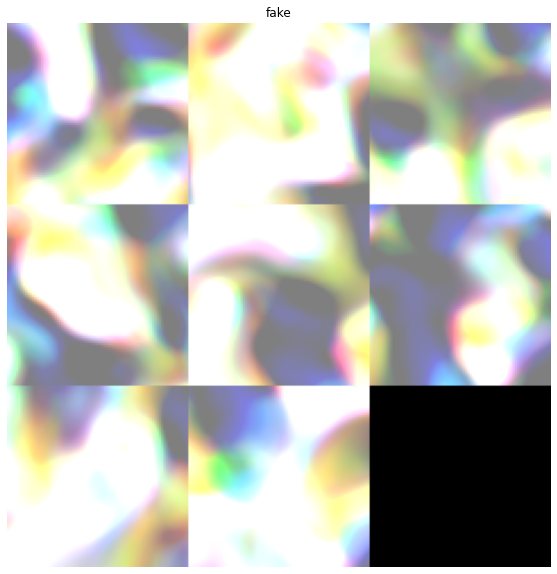

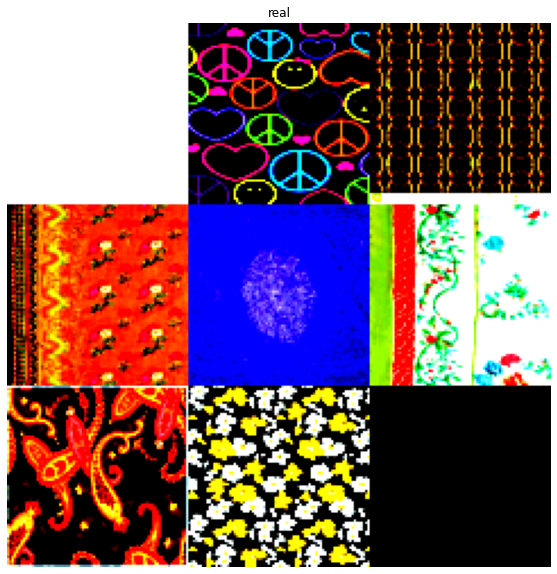

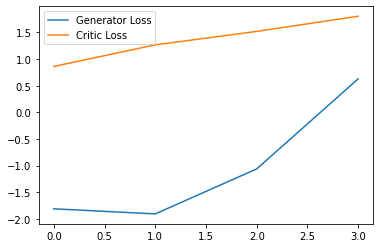

 98%|█████████▊| 85/87 [00:42<00:00,  2.02it/s]

Step 172: Generator loss: 1.890305531314076, critic loss: -5.312023008840027


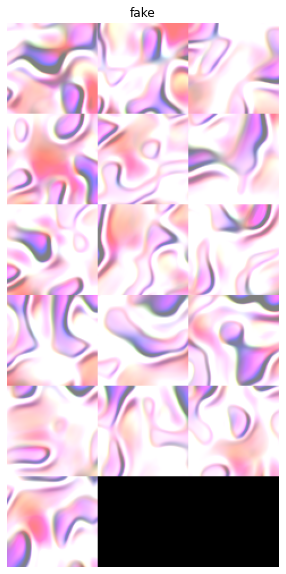

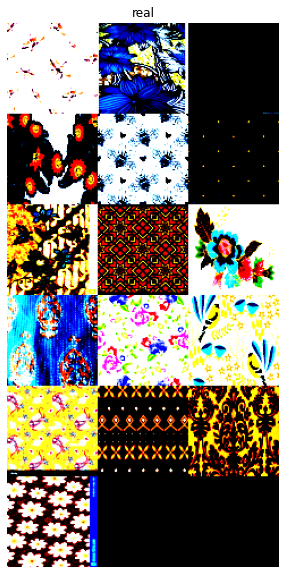

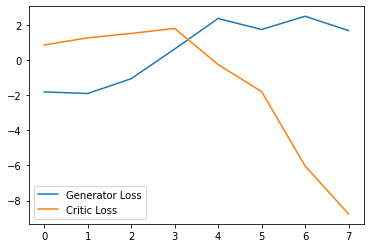

 97%|█████████▋| 84/87 [00:41<00:01,  2.03it/s]

Step 258: Generator loss: 0.6224043427121847, critic loss: -8.214474840982016


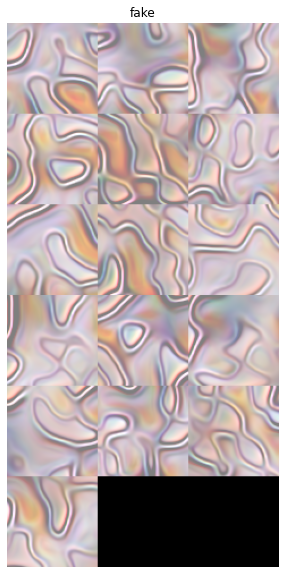

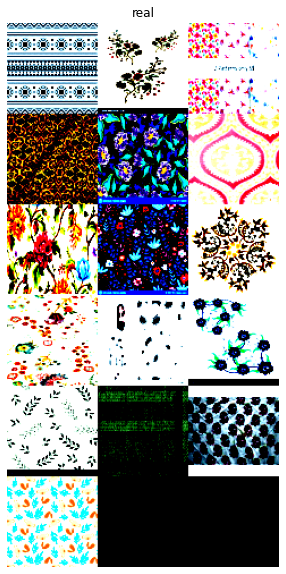

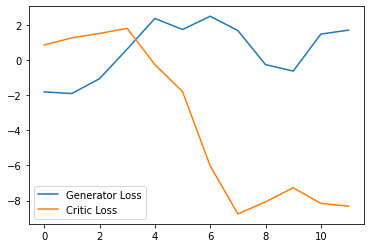

 95%|█████████▌| 83/87 [00:41<00:01,  2.02it/s]

Step 344: Generator loss: 0.918547491640459, critic loss: -9.819252465353458


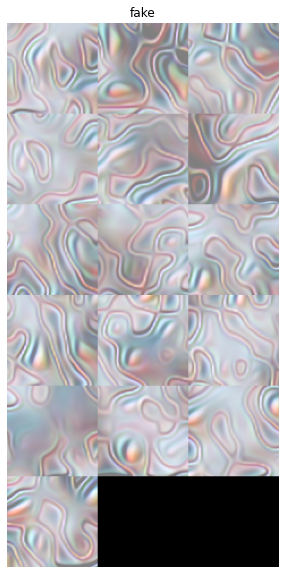

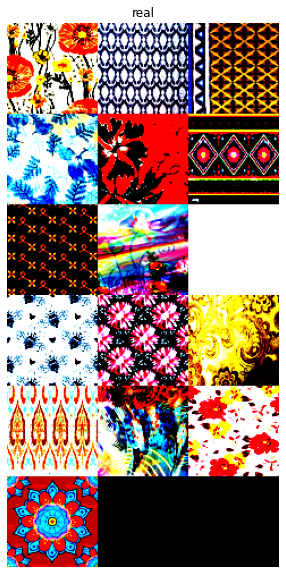

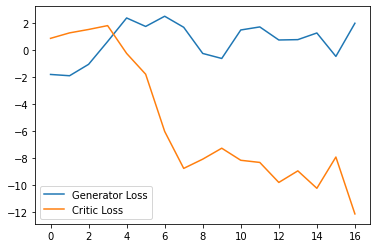

 94%|█████████▍| 82/87 [00:40<00:02,  2.01it/s]

Step 430: Generator loss: 5.810943073831325, critic loss: -13.127308053194087


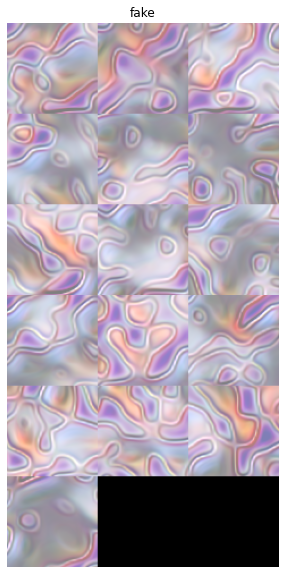

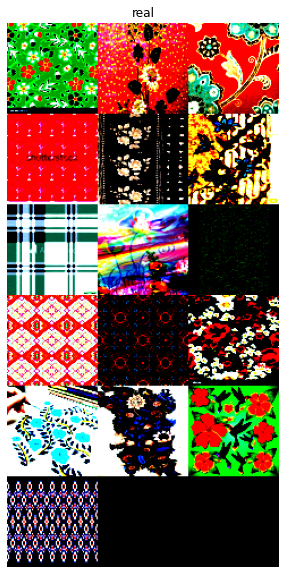

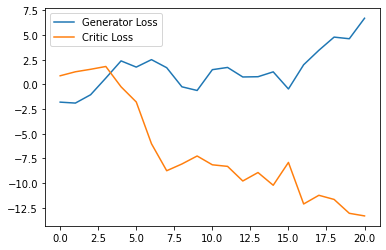

 93%|█████████▎| 81/87 [00:40<00:02,  2.03it/s]

Step 516: Generator loss: 12.3081885215848, critic loss: -14.661983197927485


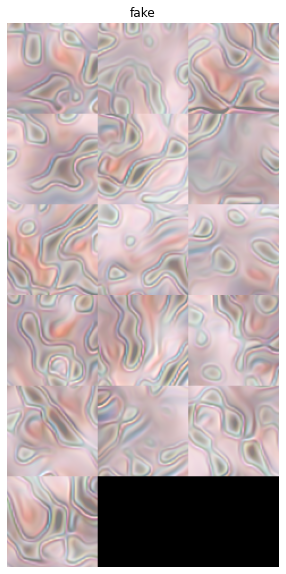

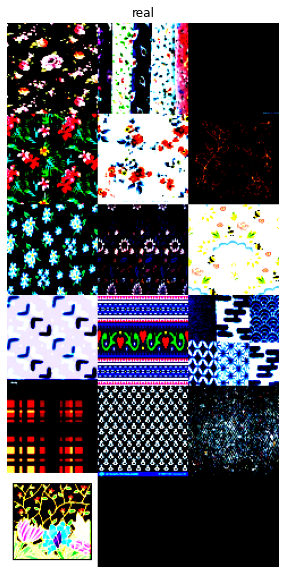

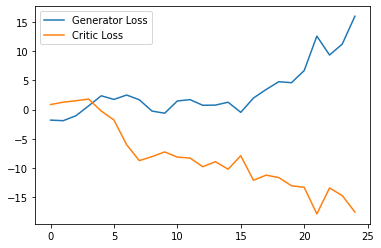

 92%|█████████▏| 80/87 [00:39<00:03,  2.03it/s]

Step 602: Generator loss: 15.229217030281244, critic loss: -16.87274453778599


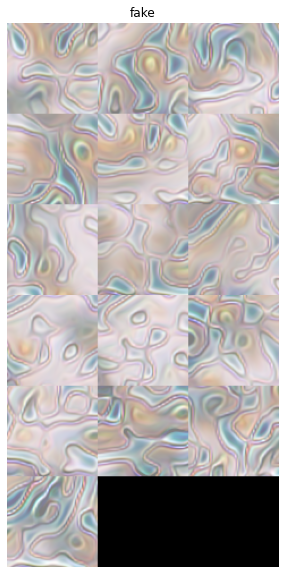

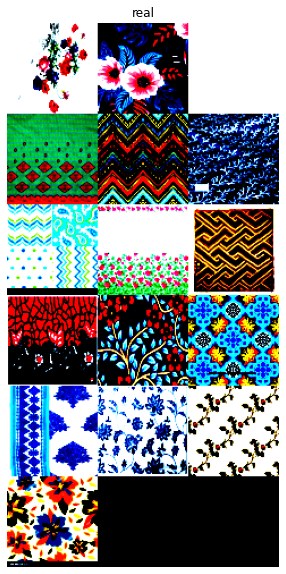

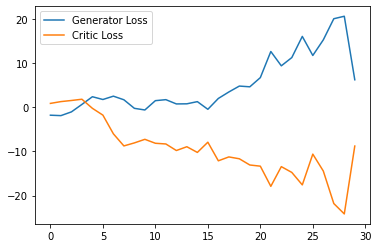

 91%|█████████ | 79/87 [00:39<00:03,  2.01it/s]

Step 688: Generator loss: 12.227508397989494, critic loss: -16.664700064132372


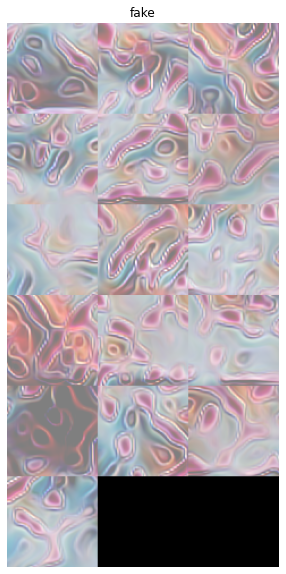

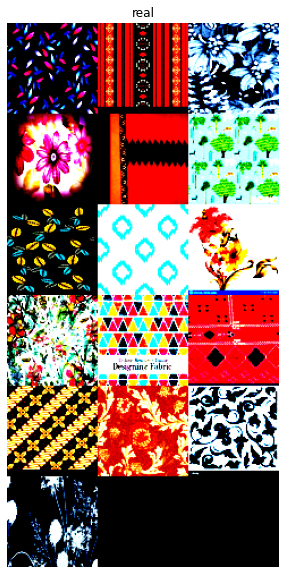

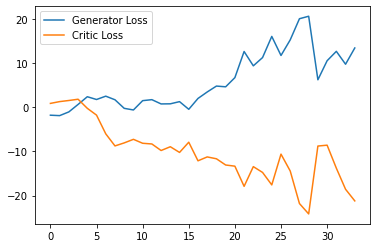

 90%|████████▉ | 78/87 [00:38<00:04,  2.02it/s]

Step 774: Generator loss: 11.697543161553005, critic loss: -18.834909912874533


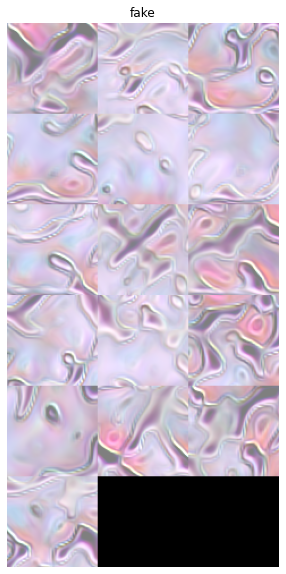

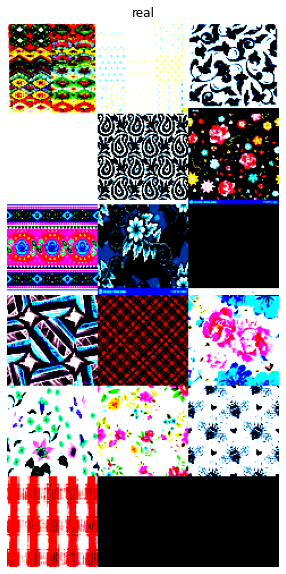

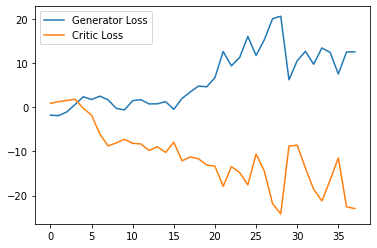

 89%|████████▊ | 77/87 [00:38<00:04,  2.01it/s]

Step 860: Generator loss: 13.610691684623097, critic loss: -18.30300547840983


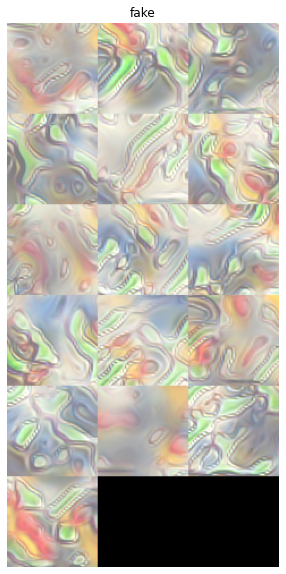

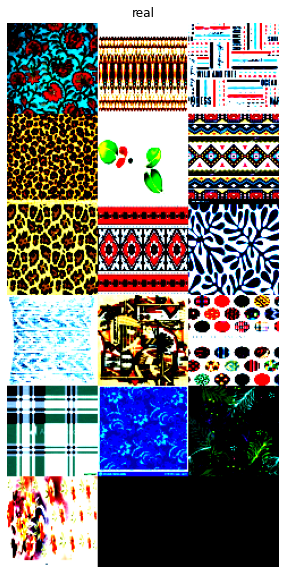

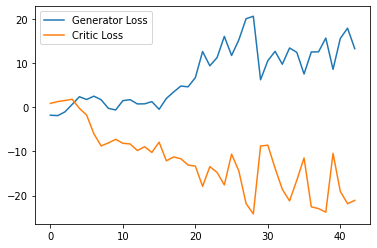

 87%|████████▋ | 76/87 [00:37<00:05,  1.99it/s]

Step 946: Generator loss: 15.23114844810131, critic loss: -22.39303304580755


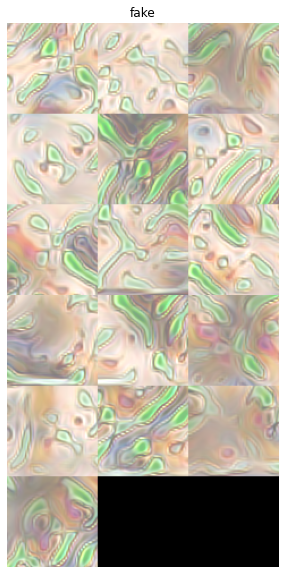

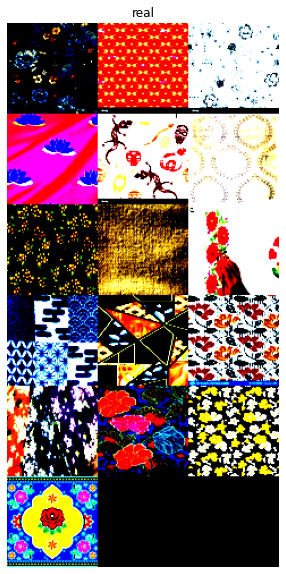

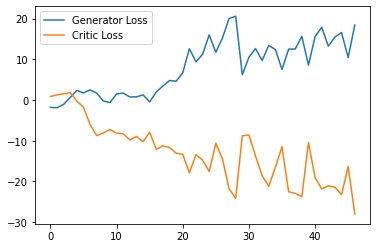

 86%|████████▌ | 75/87 [00:37<00:05,  2.02it/s]

Step 1032: Generator loss: 8.609651396094366, critic loss: -5.317381927856178


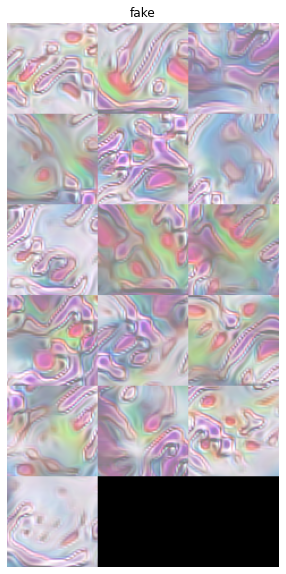

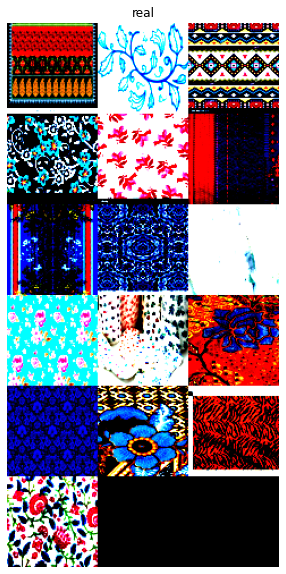

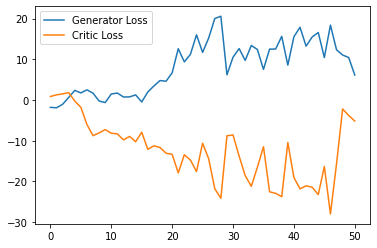

 85%|████████▌ | 74/87 [00:36<00:06,  2.02it/s]

Step 1118: Generator loss: 8.54595250445743, critic loss: -12.533874552194469


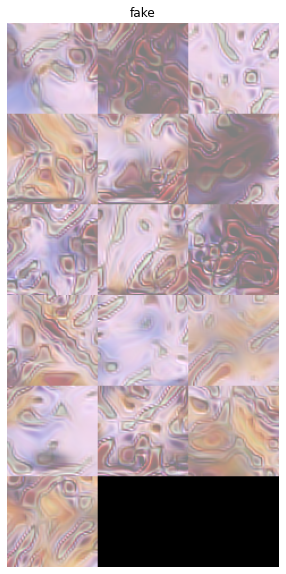

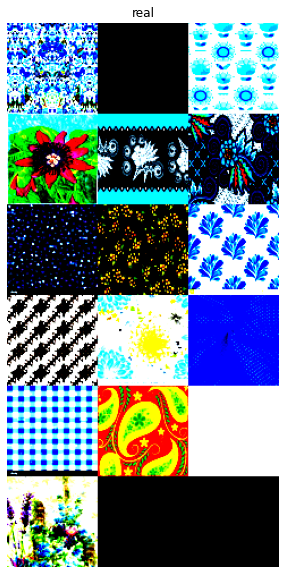

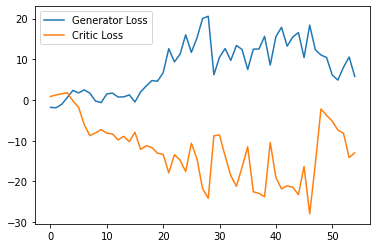

 84%|████████▍ | 73/87 [00:36<00:07,  1.99it/s]

Step 1204: Generator loss: 9.514324558335682, critic loss: -17.731989645126255


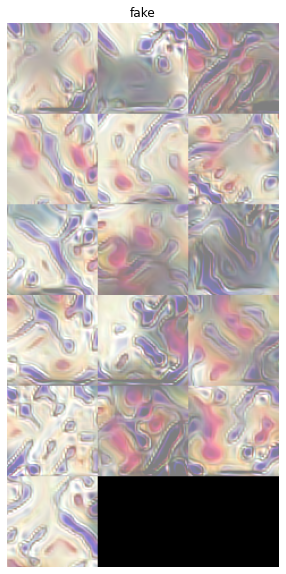

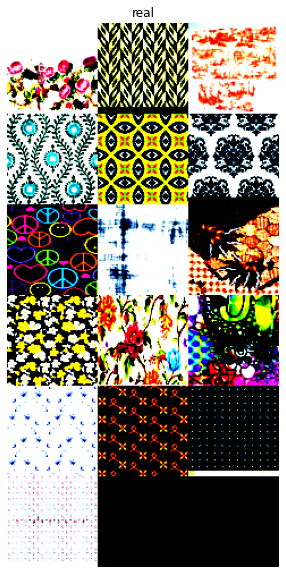

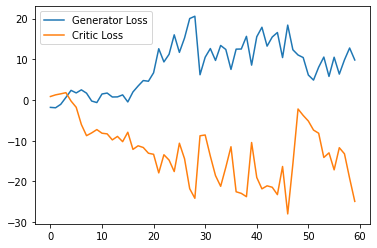

 83%|████████▎ | 72/87 [00:35<00:07,  2.02it/s]

Step 1290: Generator loss: 0.9017575391849806, critic loss: -19.87962948416554


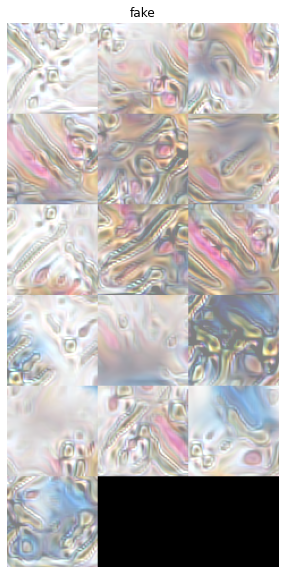

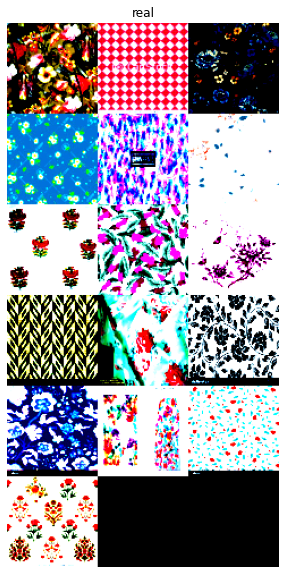

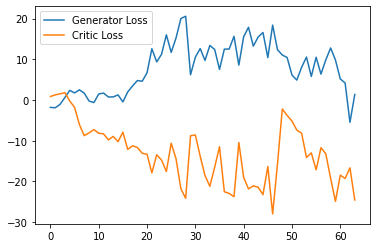

 82%|████████▏ | 71/87 [00:35<00:07,  2.03it/s]

Step 1376: Generator loss: 2.940703930474038, critic loss: -18.409085740460906


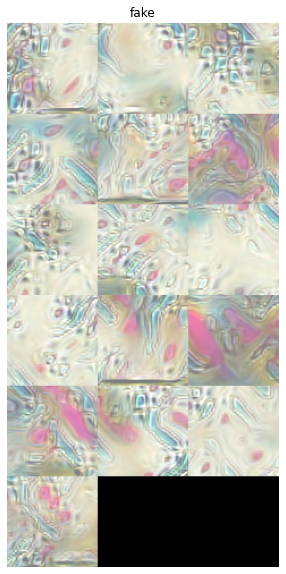

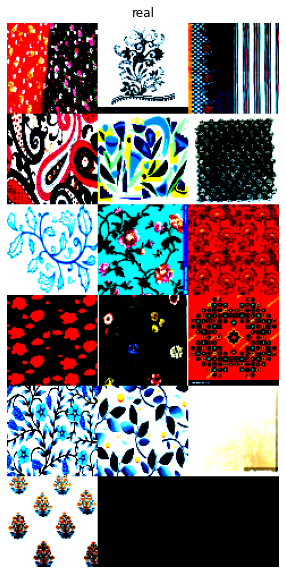

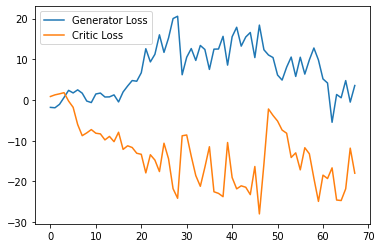

 80%|████████  | 70/87 [00:34<00:08,  2.02it/s]

Step 1462: Generator loss: 17.18341991097428, critic loss: -26.631446755556183


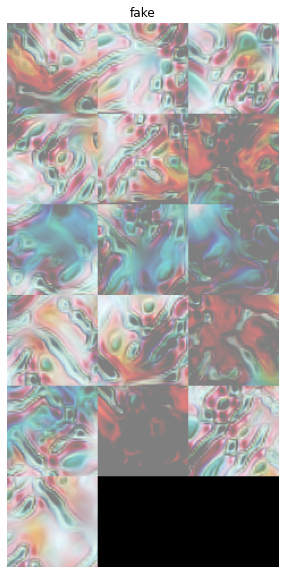

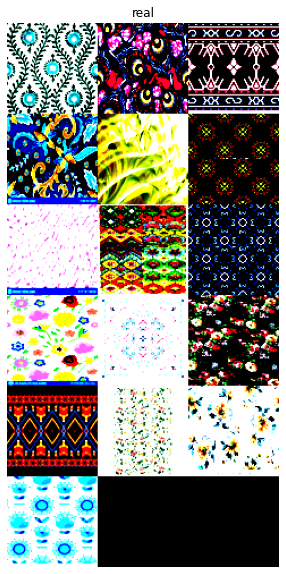

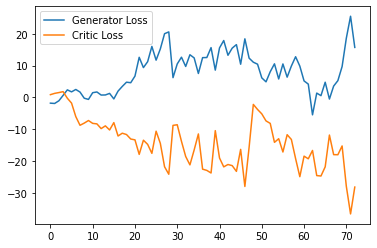

 79%|███████▉  | 69/87 [00:34<00:08,  2.02it/s]

Step 1548: Generator loss: 17.033223706622458, critic loss: -29.940375091031534


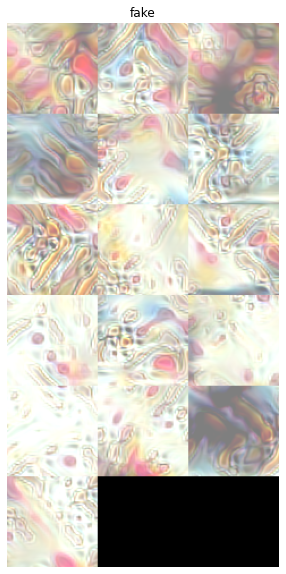

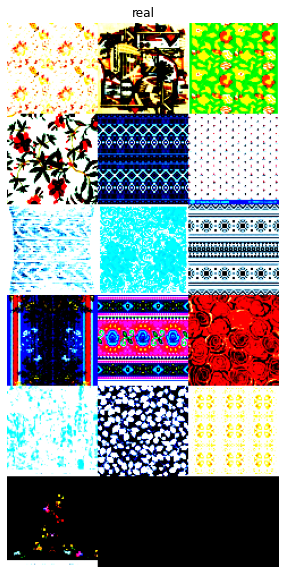

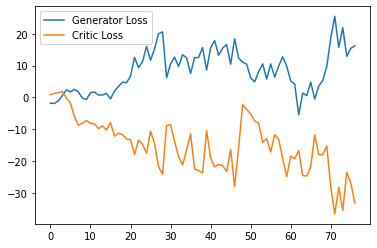

 78%|███████▊  | 68/87 [00:33<00:09,  2.03it/s]

Step 1634: Generator loss: 21.31760784637096, critic loss: -15.821729423694835


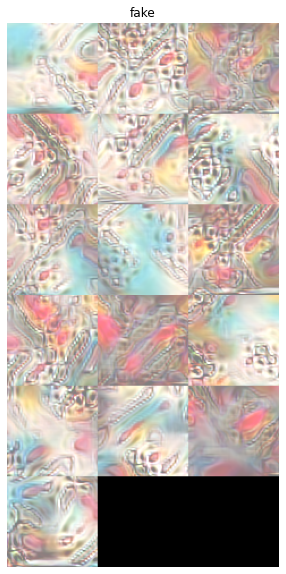

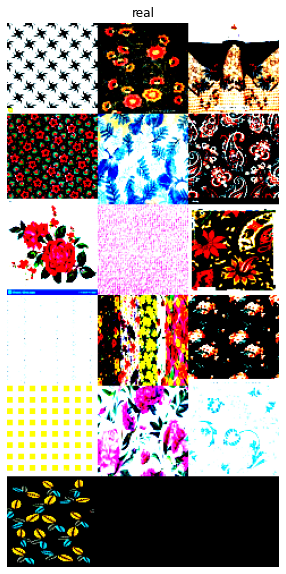

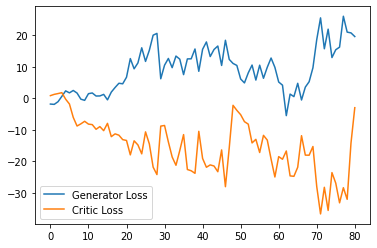

 77%|███████▋  | 67/87 [00:33<00:09,  2.03it/s]

Step 1720: Generator loss: 22.023382319960483, critic loss: -10.022667296126828


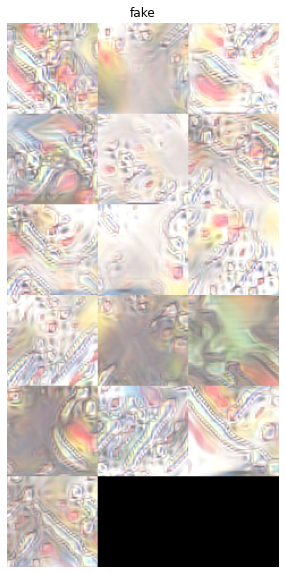

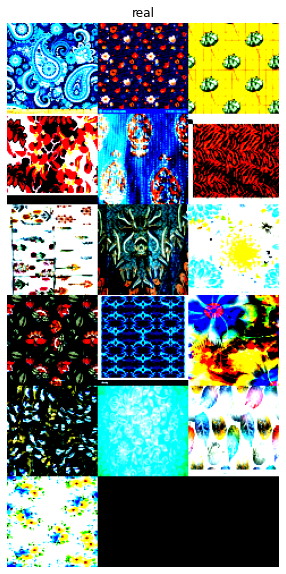

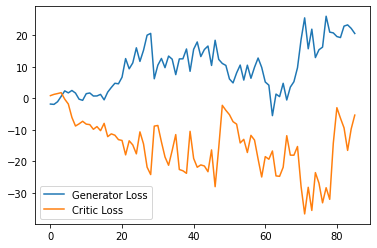

 76%|███████▌  | 66/87 [00:33<00:10,  2.02it/s]

Step 1806: Generator loss: 26.020326924878496, critic loss: -15.206234938876573


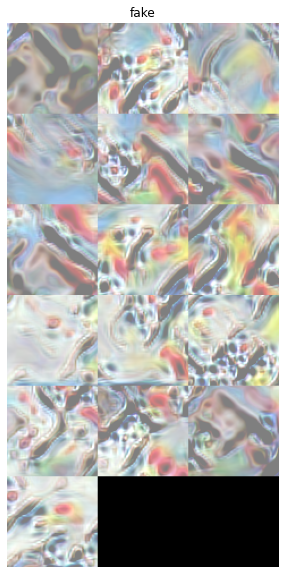

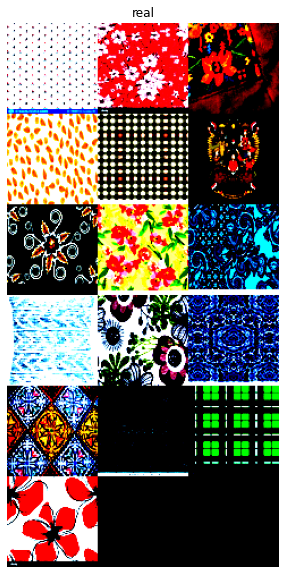

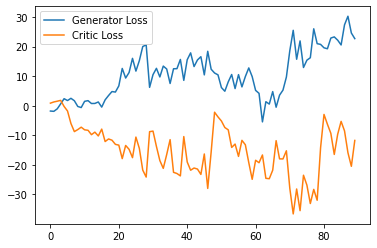

 75%|███████▍  | 65/87 [00:32<00:10,  2.03it/s]

Step 1892: Generator loss: 24.252995136172274, critic loss: -15.842317327649084


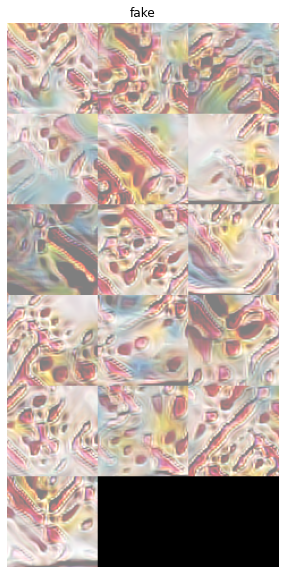

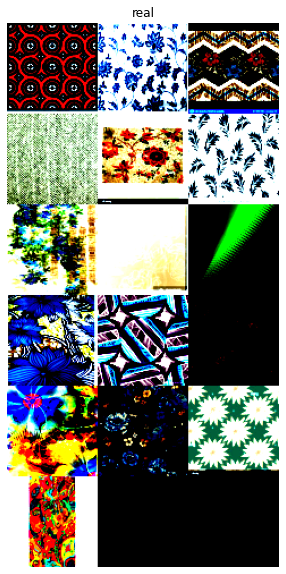

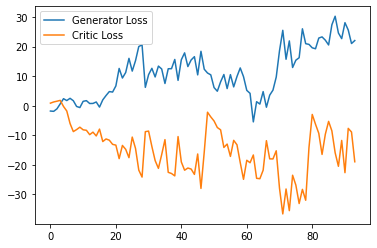

 74%|███████▎  | 64/87 [00:32<00:11,  2.03it/s]

Step 1978: Generator loss: 20.120183889255966, critic loss: -18.99875314221826


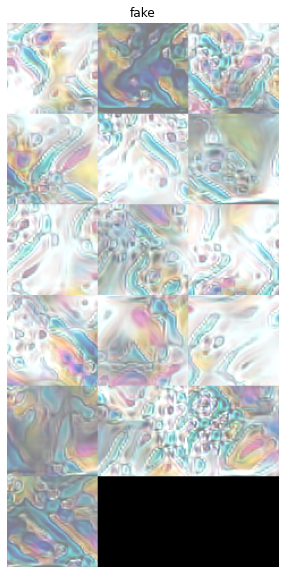

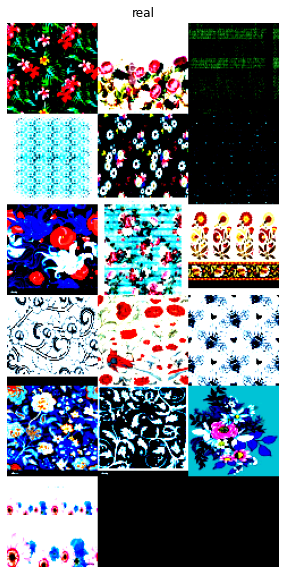

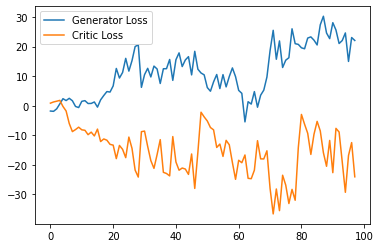

 72%|███████▏  | 63/87 [00:31<00:11,  2.02it/s]

Step 2064: Generator loss: 20.25601699463157, critic loss: -24.232575319118283


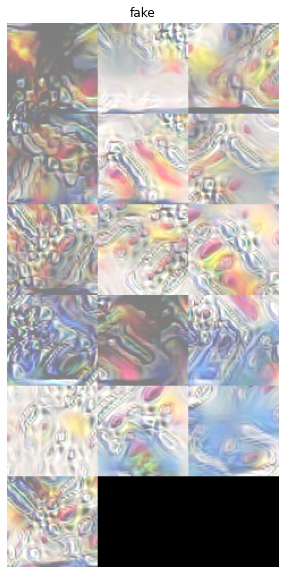

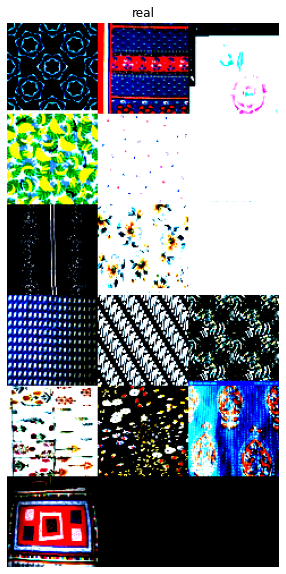

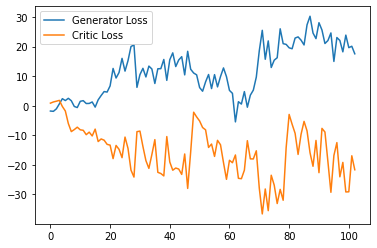

 71%|███████▏  | 62/87 [00:30<00:12,  2.03it/s]

Step 2150: Generator loss: 19.670232573220897, critic loss: -22.979825249175697


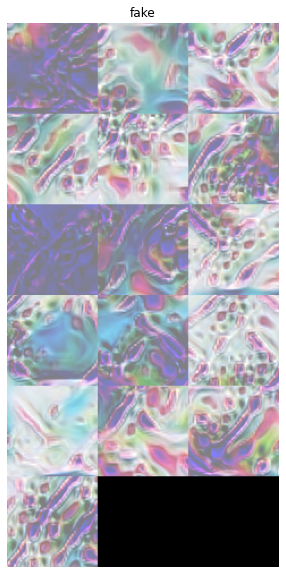

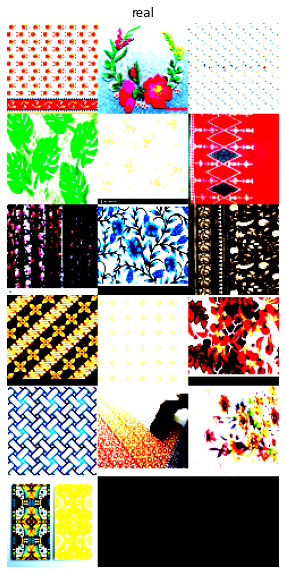

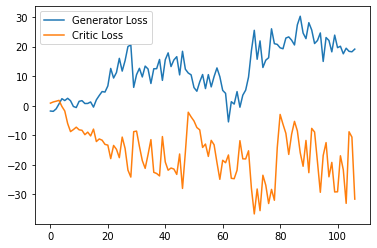

 70%|███████   | 61/87 [00:30<00:12,  2.03it/s]

Step 2236: Generator loss: 19.345528958495272, critic loss: -36.47155436416006


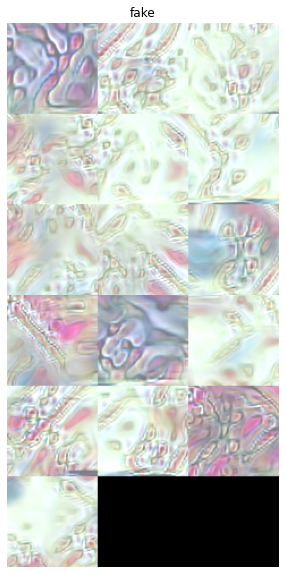

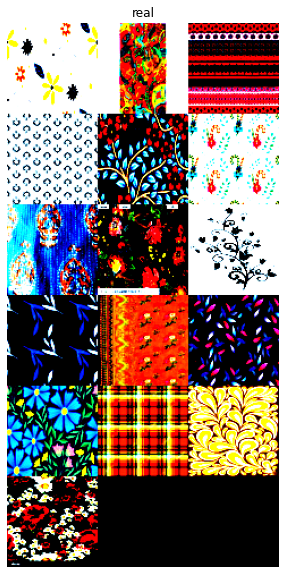

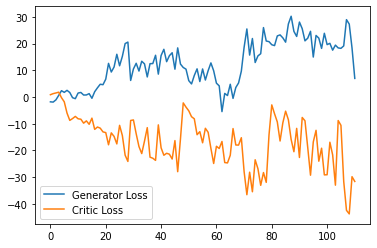

 69%|██████▉   | 60/87 [00:29<00:13,  2.01it/s]

Step 2322: Generator loss: 22.18884445345679, critic loss: -31.534053722093276


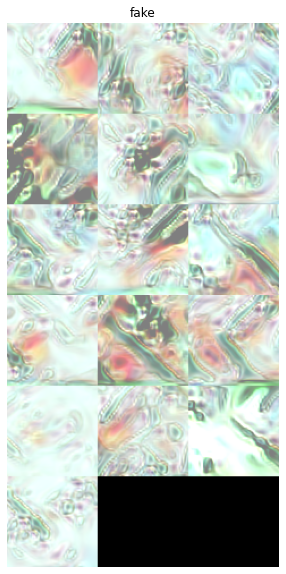

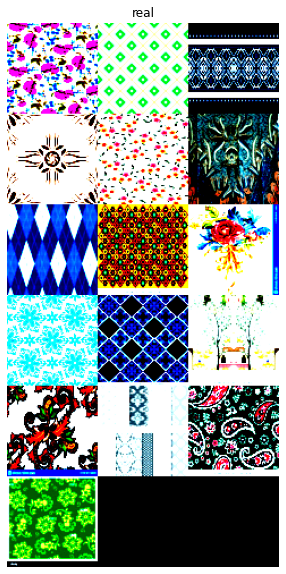

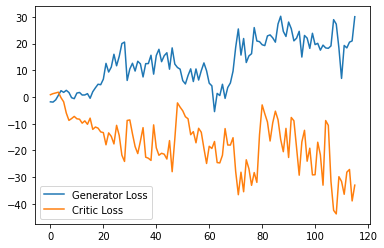

 68%|██████▊   | 59/87 [00:29<00:13,  2.02it/s]

Step 2408: Generator loss: 29.81248527349428, critic loss: -33.19444001705147


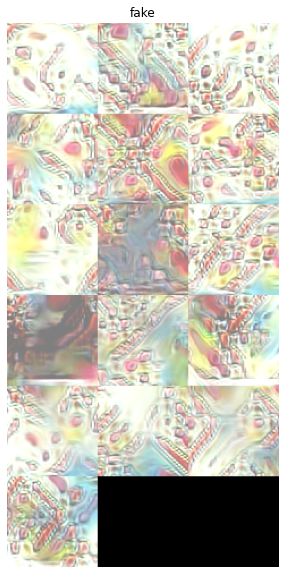

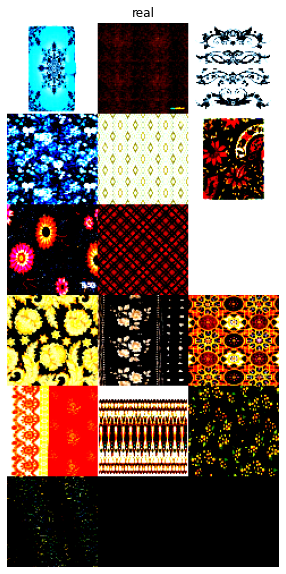

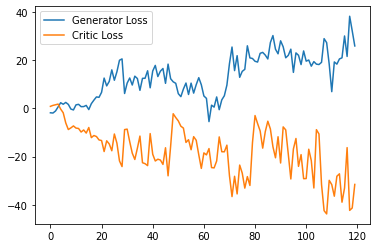

 67%|██████▋   | 58/87 [00:29<00:14,  2.02it/s]

Step 2494: Generator loss: 33.07166076260944, critic loss: -26.72687476942706


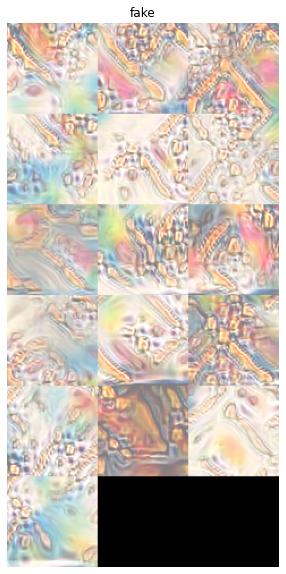

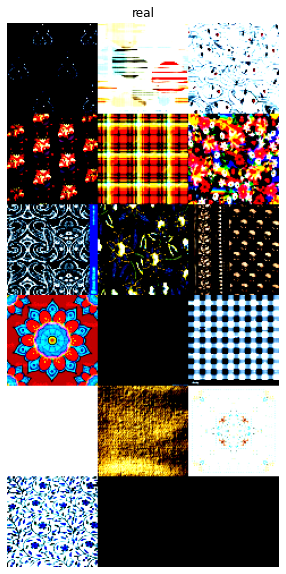

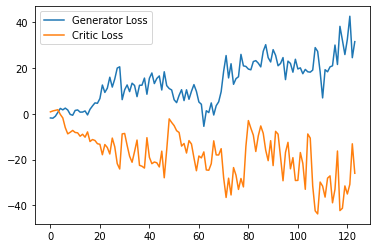

 66%|██████▌   | 57/87 [00:28<00:15,  1.97it/s]

Step 2580: Generator loss: 28.609310061432595, critic loss: -34.81022679888926


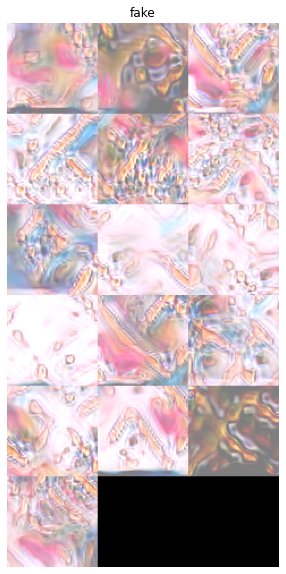

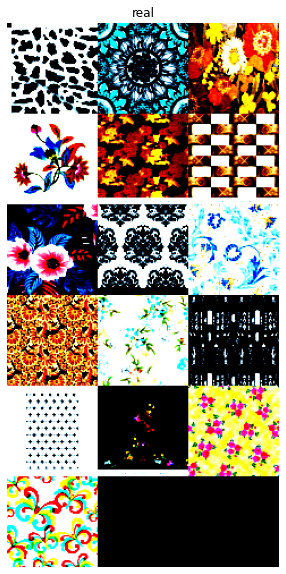

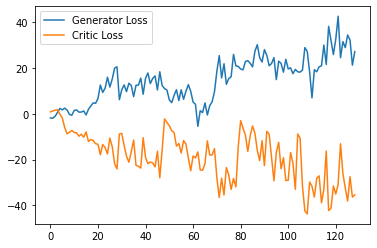

 64%|██████▍   | 56/87 [00:28<00:15,  2.01it/s]

Step 2666: Generator loss: 36.19292186027349, critic loss: -29.972752729335493


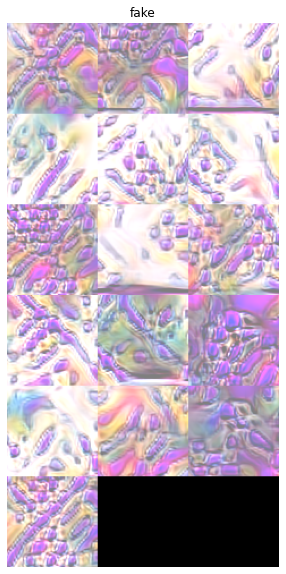

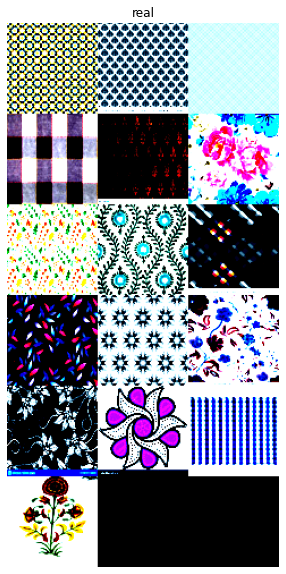

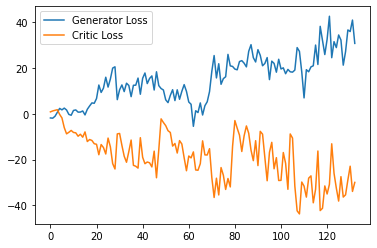

 63%|██████▎   | 55/87 [00:27<00:15,  2.02it/s]

Step 2752: Generator loss: 28.46262989487759, critic loss: -8.38607437839341


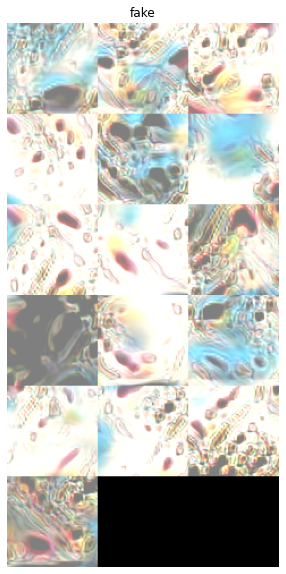

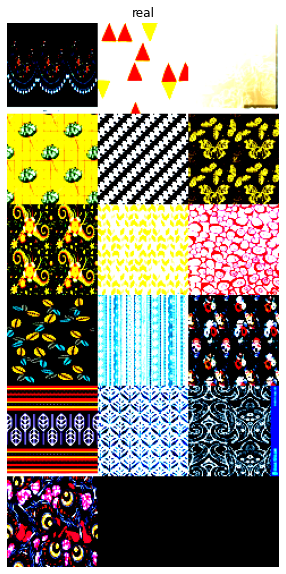

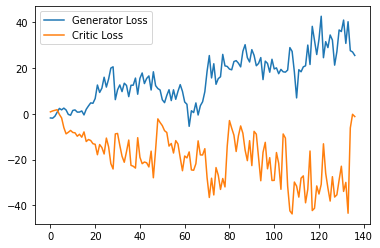

 62%|██████▏   | 54/87 [00:26<00:16,  2.01it/s]

Step 2838: Generator loss: 13.812618017196655, critic loss: -1.0266203973182413


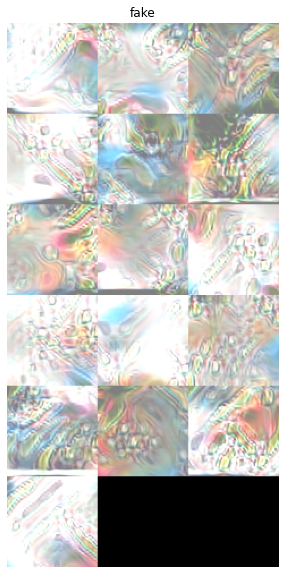

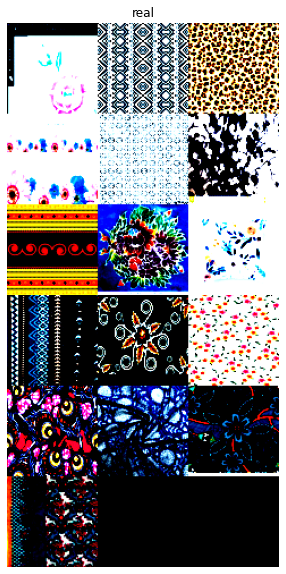

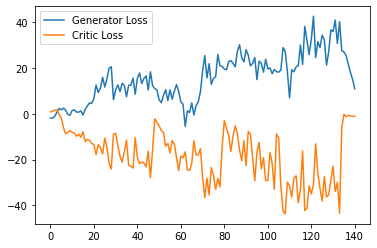

 61%|██████    | 53/87 [00:26<00:16,  2.00it/s]

Step 2924: Generator loss: -0.3716814324779566, critic loss: -1.810773097983627


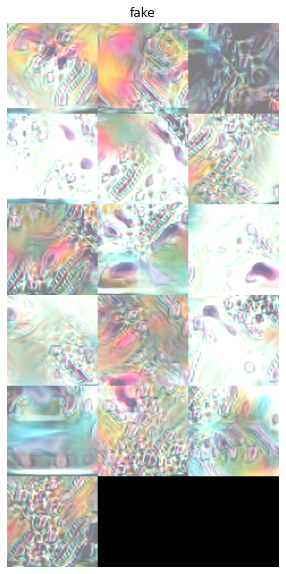

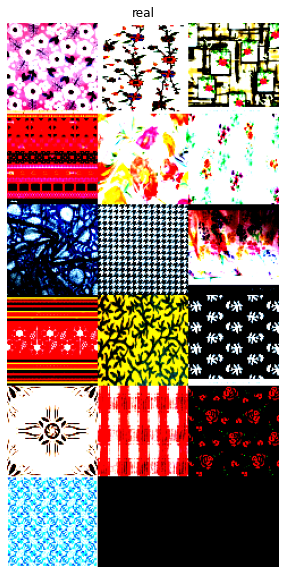

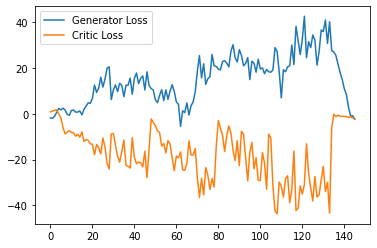

 60%|█████▉    | 52/87 [00:26<00:17,  2.03it/s]

Step 3010: Generator loss: -6.8270873746206595, critic loss: -3.0473430801962693


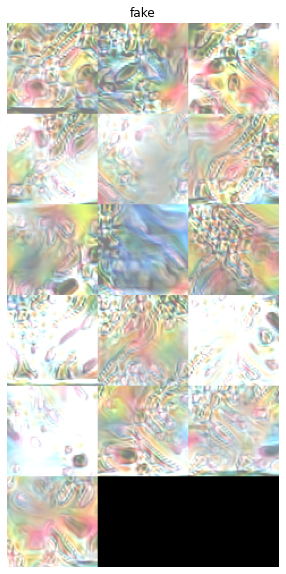

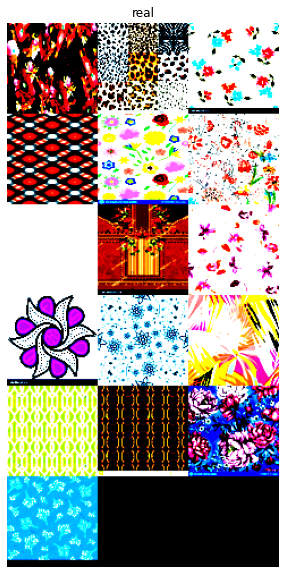

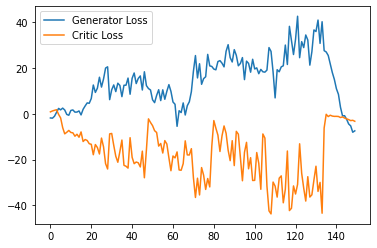

 59%|█████▊    | 51/87 [00:25<00:17,  2.02it/s]

Step 3096: Generator loss: -9.326172071833943, critic loss: -4.062432372396768


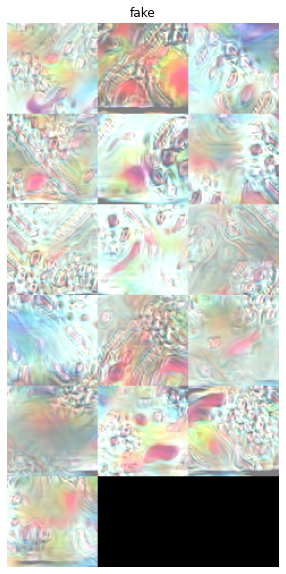

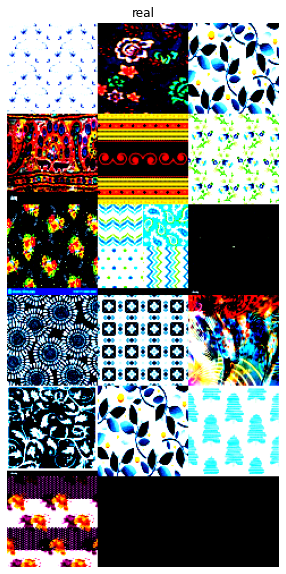

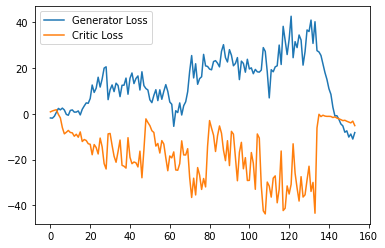

 57%|█████▋    | 50/87 [00:25<00:18,  2.02it/s]

Step 3182: Generator loss: -9.936618028685103, critic loss: -5.212936673330708


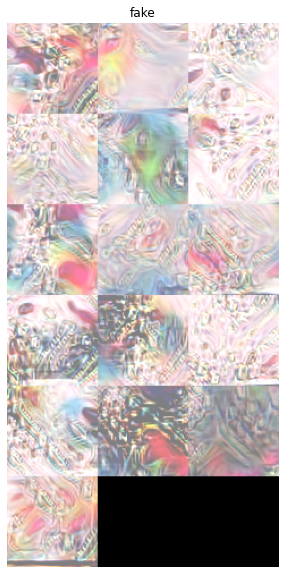

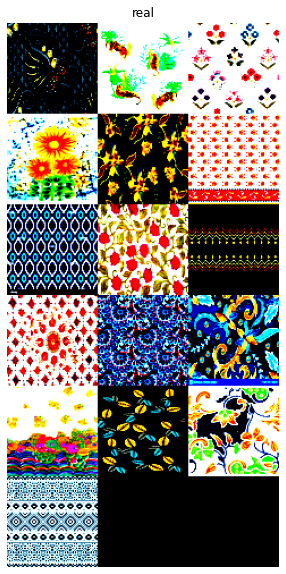

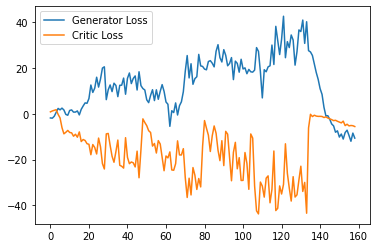

 56%|█████▋    | 49/87 [00:24<00:18,  2.02it/s]

Step 3268: Generator loss: -11.977274711741957, critic loss: -4.205720875117669


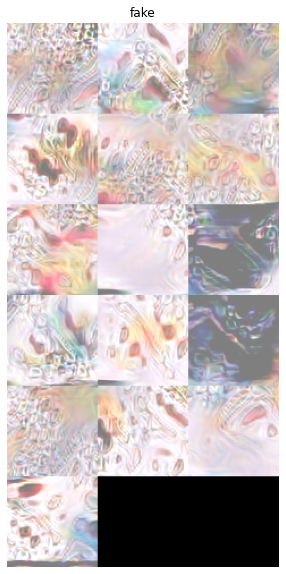

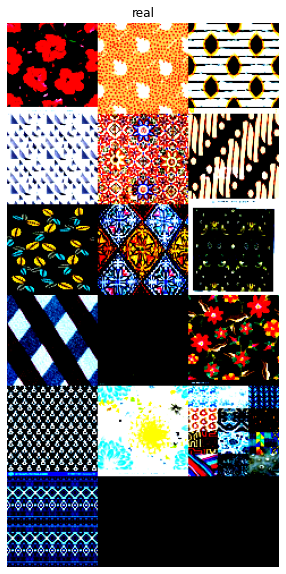

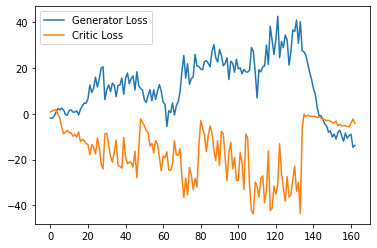

 55%|█████▌    | 48/87 [00:24<00:19,  2.03it/s]

Step 3354: Generator loss: -11.094293242277102, critic loss: -8.451139197689157


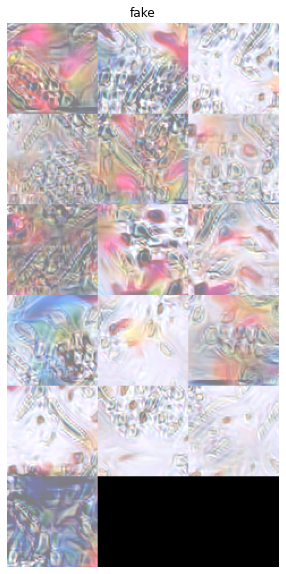

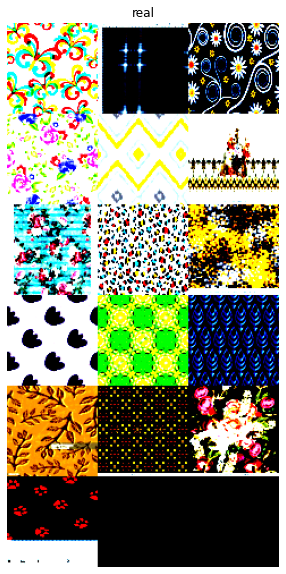

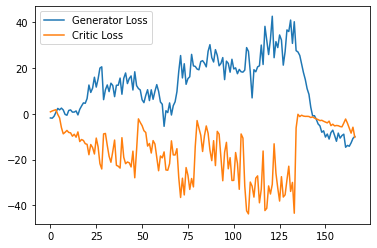

 54%|█████▍    | 47/87 [00:23<00:20,  1.97it/s]

Step 3440: Generator loss: -1.5896779972150228, critic loss: -12.723352009196613


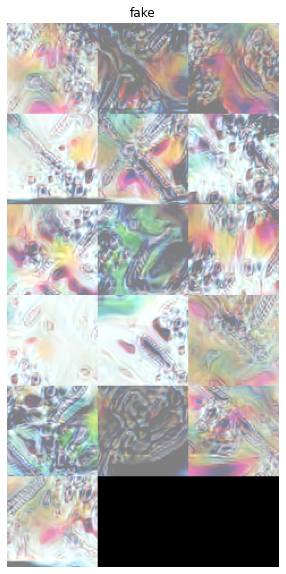

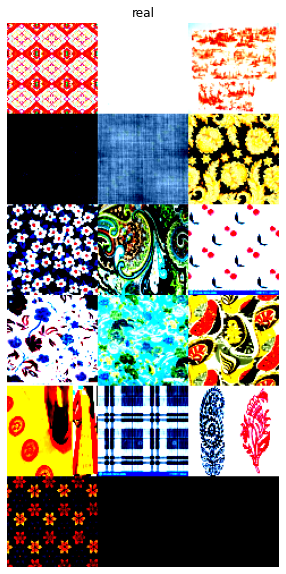

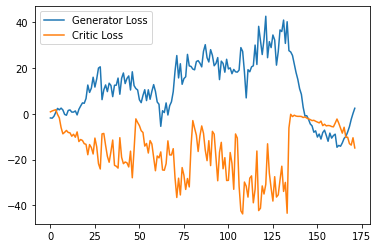

 53%|█████▎    | 46/87 [00:23<00:20,  2.03it/s]

Step 3526: Generator loss: 4.585472231860771, critic loss: -30.12865860628529


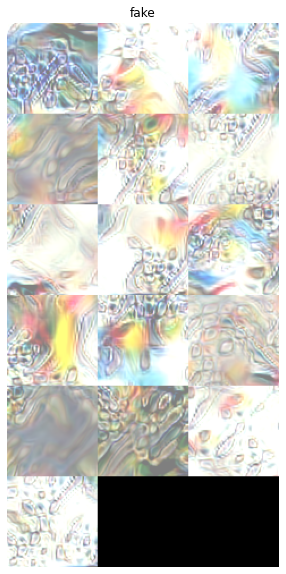

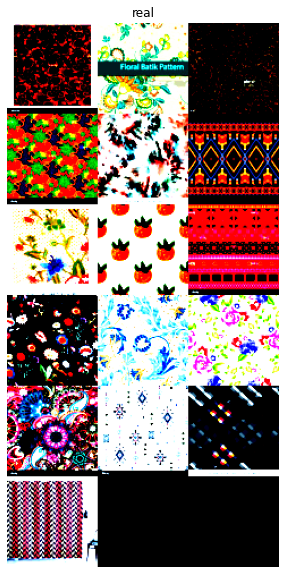

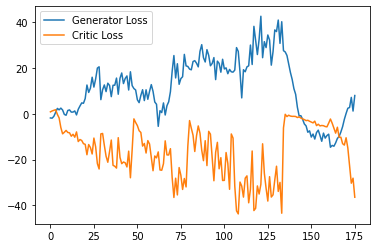

 52%|█████▏    | 45/87 [00:22<00:20,  2.02it/s]

Step 3612: Generator loss: 6.393484991433662, critic loss: -36.699794019169595


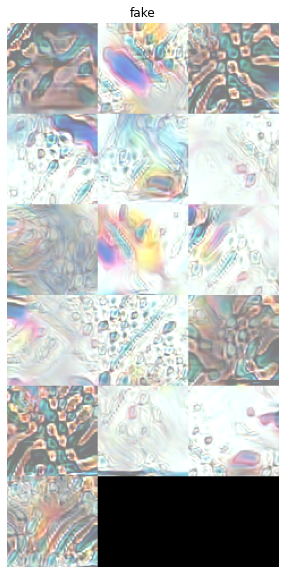

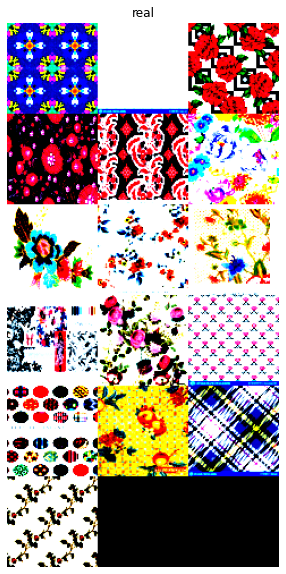

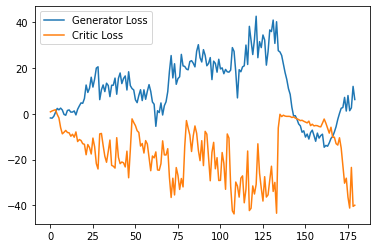

 51%|█████     | 44/87 [00:22<00:22,  1.91it/s]

Step 3698: Generator loss: 7.16820174143758, critic loss: -22.178359074509427


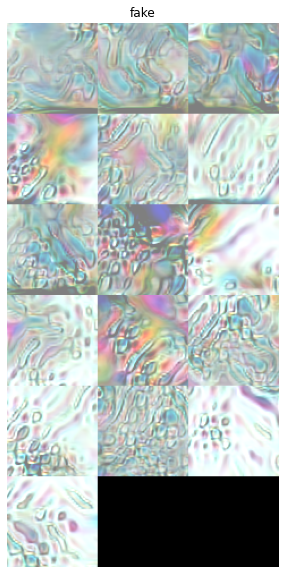

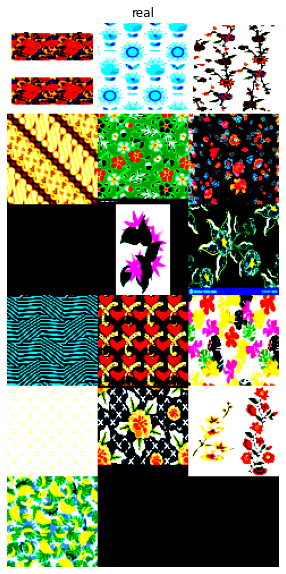

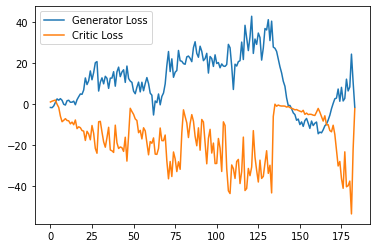

 49%|████▉     | 43/87 [00:21<00:21,  2.03it/s]

Step 3784: Generator loss: 1.542875916112301, critic loss: -4.601940354600897


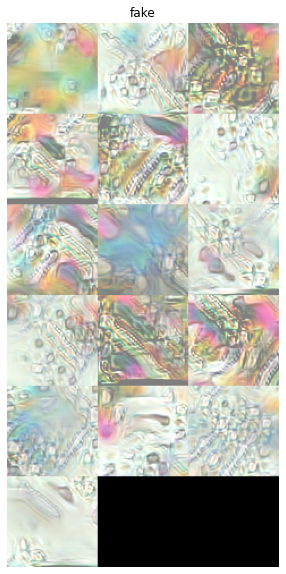

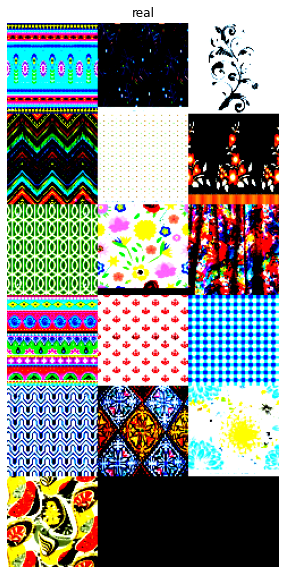

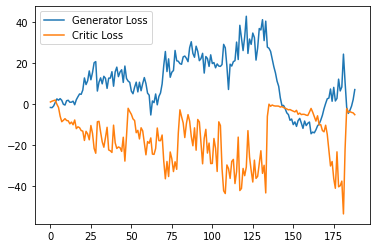

 48%|████▊     | 42/87 [00:21<00:22,  2.03it/s]

Step 3870: Generator loss: 0.7048366109266617, critic loss: -5.790864450986995


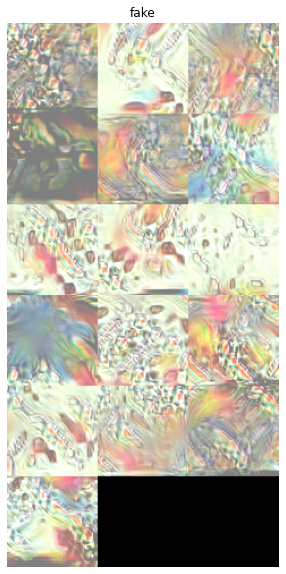

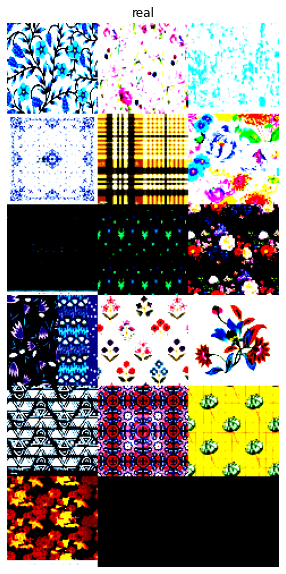

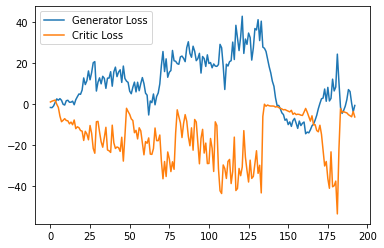

 47%|████▋     | 41/87 [00:20<00:22,  2.02it/s]

Step 3956: Generator loss: 9.609116053598564, critic loss: -10.554879349989944


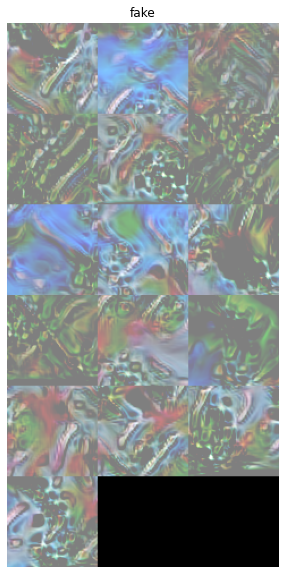

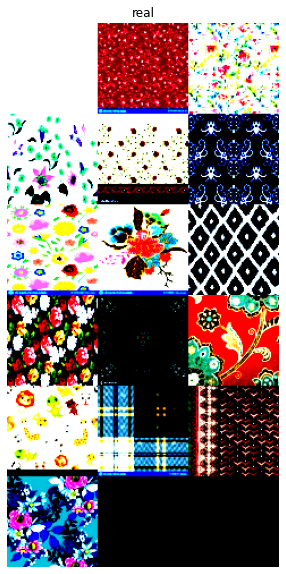

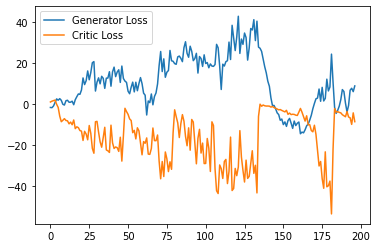

 46%|████▌     | 40/87 [00:20<00:23,  2.02it/s]

Step 4042: Generator loss: 19.051913788152294, critic loss: -26.730639069648692


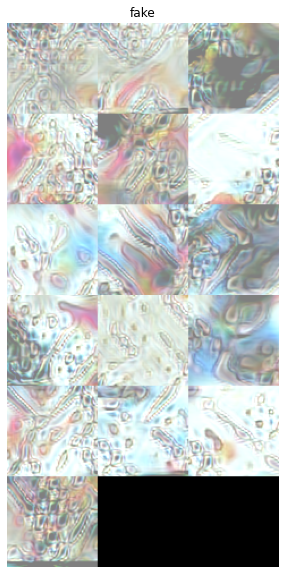

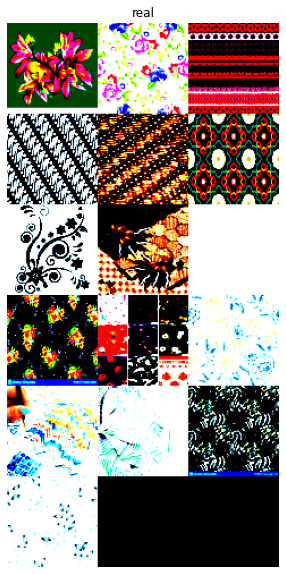

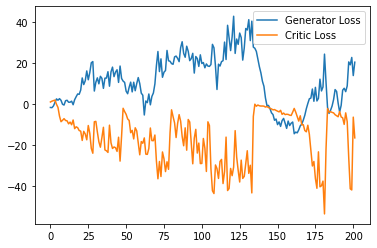

 45%|████▍     | 39/87 [00:19<00:23,  2.02it/s]

Step 4128: Generator loss: 24.401555094608042, critic loss: -11.661153002776379


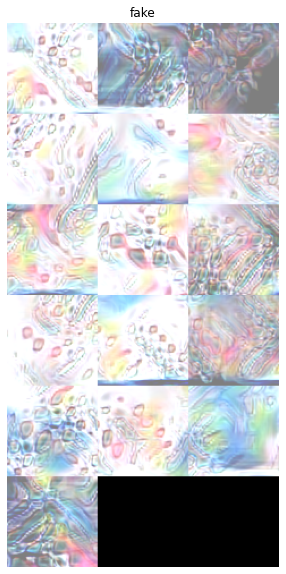

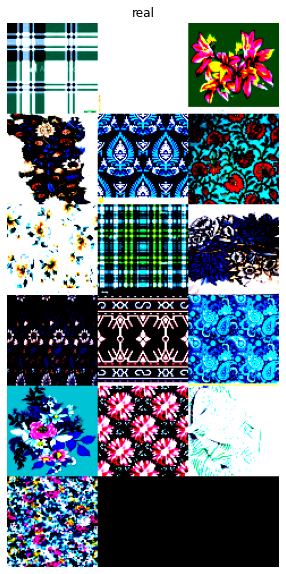

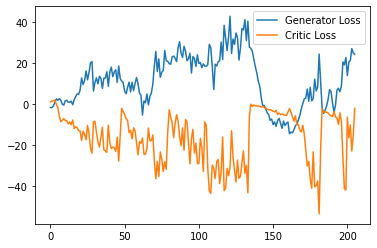

 44%|████▎     | 38/87 [00:18<00:24,  2.01it/s]

Step 4214: Generator loss: 23.252065020938254, critic loss: -10.237886394525683


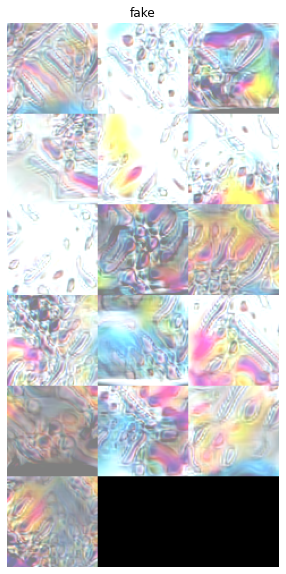

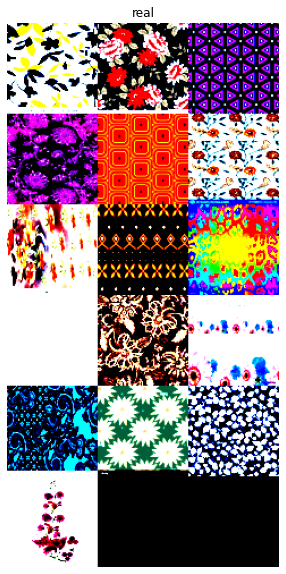

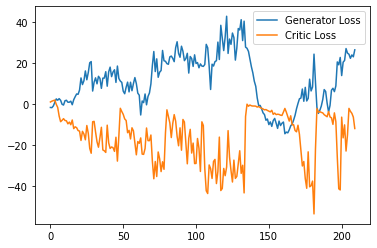

 43%|████▎     | 37/87 [00:18<00:24,  2.02it/s]

Step 4300: Generator loss: 20.470521594202797, critic loss: -19.1721620906231


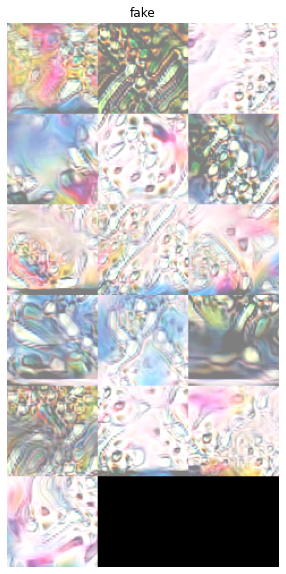

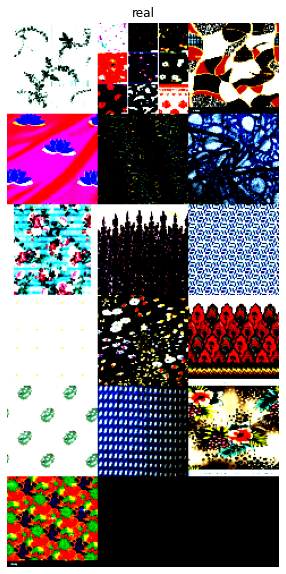

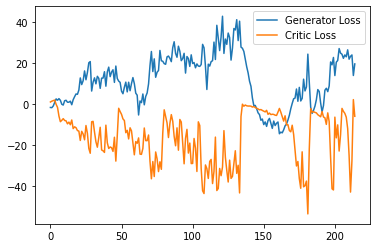

100%|██████████| 87/87 [00:43<00:00,  1.98it/s]


In [5]:
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from tqdm import tqdm

lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10

gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples, z_dim, device=device)


n_epochs = 50
display_step = int(len(dataloader.dataset)/batch_size)
cur_step = 0
generator_losses = []
critic_losses = []
crit_repeats = 10
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = F.interpolate(real, size=(im_size, im_size)).to(device)

        mean_iteration_critic_loss = 0.0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

            ### Update generator ###
        for _ in range(1):
            gen_opt.zero_grad()
            fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
            fake_2 = gen(fake_noise_2)
            crit_fake_pred = crit(fake_2)

            gen_loss = get_gen_loss(crit_fake_pred)
            gen_loss.backward()

            # Update the weights
            gen_opt.step()
            # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            

            show_tensor_images('fake',fake)
            show_tensor_images('real',real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1

In [6]:
torch.save(gen.state_dict(), 'gen.pth')
torch.save(crit.state_dict(), 'crit.pth')

In [7]:
import torch
from tqdm import tqdm
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
from torch.utils import data
dataset = datasets.ImageFolder('./fabric_dataset', transform=transforms.Compose([transforms.Resize(64),
                             transforms.CenterCrop(64),
                             transforms.ToTensor()]))

loader = data.DataLoader(dataset,
                         batch_size=10,
                         num_workers=0,
                         shuffle=False)

mean = 0.0
for images, _ in loader:
    batch_samples = images.size(0) 
    images = images.view(batch_samples, images.size(1), -1)
    mean += images.mean(2).sum(0)
mean = mean / len(loader.dataset)

var = 0.0
for images, _ in loader:
    batch_samples = images.size(0)
    images = images.view(batch_samples, images.size(1), -1)
    var += ((images - mean.unsqueeze(1))**2).sum([0,2])
std = torch.sqrt(var / (len(loader.dataset)*224*224))

print(mean, std)

tensor([0.6002, 0.5573, 0.5342]) tensor([0.0825, 0.0801, 0.0796])
